In [67]:
import numpy as np
import pandas as pd

# Data cleaning

## Data discovery

In [68]:
data=pd.read_csv("data.csv")
backup=data.copy()

In [69]:
data.dtypes.value_counts()

float64    93
int64       3
Name: count, dtype: int64

In [70]:
isnulltable=pd.DataFrame(data.isna().sum(), columns=["value"])

In [71]:
isnulltable.reset_index()

,index,value
0,Bankrupt?,0
1,ROA(C) before interest and depreciation befor...,0
2,ROA(A) before interest and % after tax,0
3,ROA(B) before interest and depreciation after...,0
4,Operating Gross Margin,0
5,Realized Sales Gross Margin,0
6,Operating Profit Rate,0
7,Pre-tax net Interest Rate,0
8,After-tax net Interest Rate,0
9,Non-industry income and expenditure/revenue,0


In [72]:
isnulltable.loc[isnulltable["value"]>0]

,value


In [73]:
data.describe()
# 6819 rows 
# 96 columns 


,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
count,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,...,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00
mean,0.03,0.51,0.56,0.55,0.61,0.61,1.00,0.80,0.81,0.30,...,0.81,18629417.81,0.62,0.61,0.84,0.28,0.03,0.57,1.00,0.05
std,0.18,0.06,0.07,0.06,0.02,0.02,0.01,0.01,0.01,0.01,...,0.04,376450059.75,0.01,0.02,0.01,0.01,0.02,0.01,0.00,0.05
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
25%,0.00,0.48,0.54,0.53,0.60,0.60,1.00,0.80,0.81,0.30,...,0.80,0.00,0.62,0.60,0.84,0.28,0.03,0.57,1.00,0.02
50%,0.00,0.50,0.56,0.55,0.61,0.61,1.00,0.80,0.81,0.30,...,0.81,0.00,0.62,0.61,0.84,0.28,0.03,0.57,1.00,0.03
75%,0.00,0.54,0.59,0.58,0.61,0.61,1.00,0.80,0.81,0.30,...,0.83,0.01,0.62,0.61,0.84,0.28,0.03,0.57,1.00,0.05
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,9820000000.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


<Axes: >

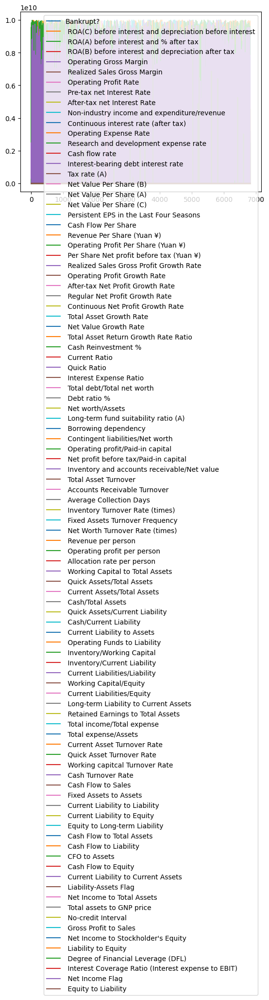

In [74]:
import matplotlib
from matplotlib import pyplot as plt 
data.plot()

## Correlations

In [75]:
# import pandas as pd
# import numpy as np

# df = pd.DataFrame({'A': [1,2,3,4,5],'B': [1,2,3,4,5], 'C':[7,3,89,2,40]})
# display(df)

# # # Create correlation matrix
# corr_matrix = df.corr().abs()
# # # Select upper triangle of correlation matrix
# upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
# # # Find features with correlation greater than 0.85
# to_drop = [column for column in upper.columns if any(upper[column] > 0.85)]

# print(f"Columns to drop: {to_drop}")
# print(f"Number of columns to drop; {len(to_drop)}")

# # # Drop features
# df.drop(to_drop, axis=1, inplace=True)
# display(df)

In [76]:
import seaborn as sns
data_matrix=data.corr()
data_matrix

for column in data_matrix:
    print(data_matrix[column].values)
# 
# for each column, 
# print column name, 
# if the value of the row is > to 0.9, 
# print the name of the row 


[ 1.00000000e+00 -2.60806558e-01 -2.82940585e-01 -2.73051318e-01
 -1.00043244e-01 -9.94452496e-02 -2.29817399e-04 -8.51654796e-03
 -8.85722326e-03 -1.65926376e-02 -8.39485899e-03 -6.08322551e-03
 -2.42319684e-02 -7.23555512e-02 -2.30628090e-02 -1.09705669e-01
 -1.65399021e-01 -1.65464759e-01 -1.64783924e-01 -2.19559681e-01
 -7.75164598e-02 -4.69203820e-03 -1.42050582e-01 -2.01394834e-01
 -4.58383763e-04 -1.51679461e-02 -3.77829729e-02 -3.68196768e-02
 -9.40090214e-03 -4.44310214e-02  6.53294244e-02 -1.68576794e-02
 -5.13452043e-02 -2.21128025e-03  2.50582887e-02 -2.68093382e-03
  1.23135860e-02  2.50160962e-01 -2.50160962e-01  1.69199048e-02
  1.76542936e-01  7.04545248e-02 -1.41111324e-01 -2.07856520e-01
  7.52780821e-02 -6.79151672e-02 -4.75386744e-03 -6.55553959e-03
 -1.37584476e-03  7.28182642e-02  2.10891883e-02  3.97184765e-02
 -9.28421410e-02  2.82880213e-03 -1.93083376e-01 -8.63821115e-02
 -4.48233389e-02 -1.00130190e-01 -3.82278014e-03  7.79210962e-02
  1.94494436e-01 -7.70819

In [77]:
mask=np.zeros_like(data_matrix, dtype=bool)
mask[np.triu_indices_from(mask)]= True

In [78]:
cmap=sns.diverging_palette(180, 180, as_cmap=True)

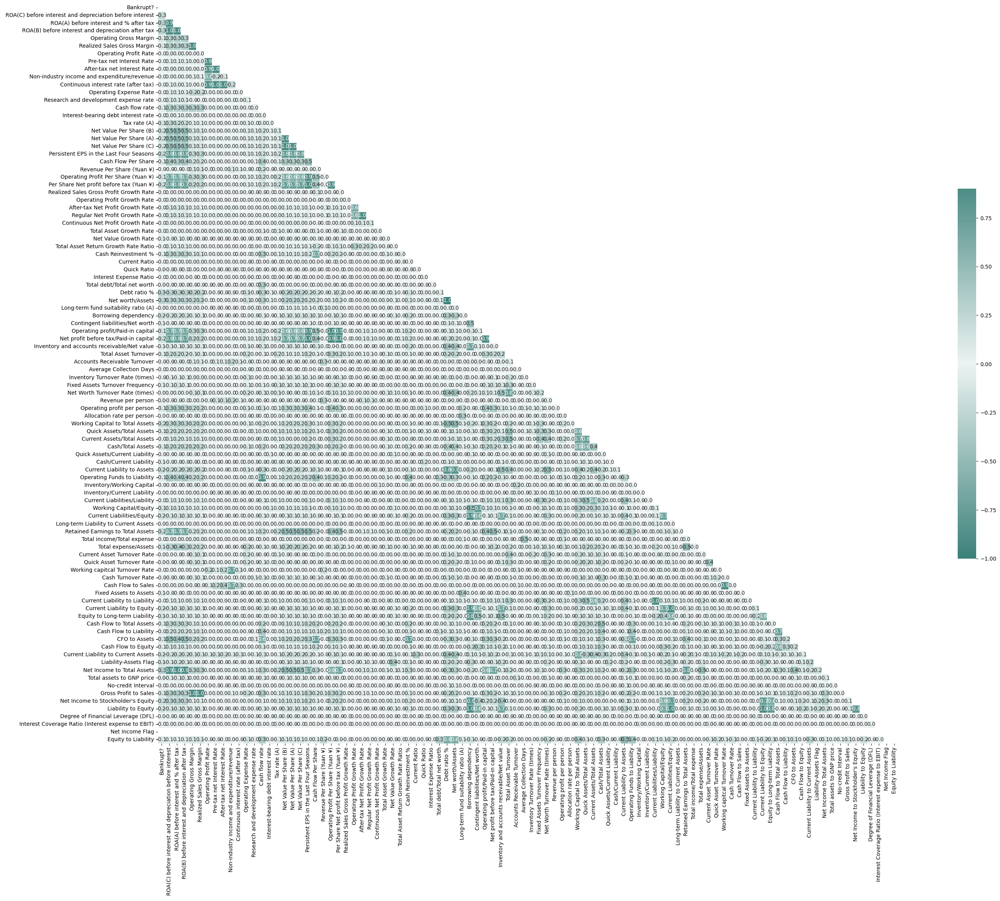

In [79]:
plt.figure(figsize=(40,25))
sns.plot = sns.heatmap(
    data_matrix, 
    mask=mask,
    cmap=cmap,
    vmax=.9,
    center=0,
    square=True,
    linewidths=.5,
    cbar_kws={"shrink": .5},
    annot=True, 
    fmt=".1f")

In [80]:
upper_tri = data_matrix.where(np.triu(np.ones(data_matrix.shape),k=1).astype(bool))

In [81]:
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.90)]

In [82]:
to_drop

[' ROA(A) before interest and % after tax',
 ' ROA(B) before interest and depreciation after tax',
 ' Realized Sales Gross Margin',
 ' Pre-tax net Interest Rate',
 ' After-tax net Interest Rate',
 ' Continuous interest rate (after tax)',
 ' Net Value Per Share (A)',
 ' Net Value Per Share (C)',
 ' Per Share Net profit before tax (Yuan ¥)',
 ' Regular Net Profit Growth Rate',
 ' Operating profit/Paid-in capital',
 ' Net profit before tax/Paid-in capital',
 ' Cash Flow to Sales',
 ' Current Liability to Liability',
 ' Current Liability to Equity',
 ' Net Income to Total Assets',
 ' Gross Profit to Sales',
 ' Liability to Equity']

In [83]:
data.drop(columns=to_drop, inplace=True)

In [84]:
# for column in data_matrix:
#     print(column)
#     for i in data_matrix[column].values:
#         if i > 0.9:
#             print(i)

In [85]:
# for (columnName, columnData) in data_matrix.iteritems():
#     print('Column Name :', columnName)
#     #if columnData.values >0.9:
#         print('Correlation Value:', columnData.values)
#         print('Row Index:', columnData.index)

## Dropping columns with low variance

In [86]:
data.describe()

,Bankrupt?,ROA(C) before interest and depreciation before interest,Operating Gross Margin,Operating Profit Rate,Non-industry income and expenditure/revenue,Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),...,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Total assets to GNP price,No-credit Interval,Net Income to Stockholder's Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
count,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,...,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00
mean,0.03,0.51,0.61,1.00,0.30,1995347312.80,1950427306.06,0.47,16448012.91,0.12,...,0.32,0.03,0.00,18629417.81,0.62,0.84,0.03,0.57,1.00,0.05
std,0.18,0.06,0.02,0.01,0.01,3237683890.52,2598291554.00,0.02,108275033.53,0.14,...,0.01,0.03,0.03,376450059.75,0.01,0.01,0.02,0.01,0.00,0.05
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
25%,0.00,0.48,0.60,1.00,0.30,0.00,0.00,0.46,0.00,0.00,...,0.31,0.02,0.00,0.00,0.62,0.84,0.03,0.57,1.00,0.02
50%,0.00,0.50,0.61,1.00,0.30,0.00,509000000.00,0.47,0.00,0.07,...,0.31,0.03,0.00,0.00,0.62,0.84,0.03,0.57,1.00,0.03
75%,0.00,0.54,0.61,1.00,0.30,4145000000.00,3450000000.00,0.47,0.00,0.21,...,0.32,0.04,0.00,0.01,0.62,0.84,0.03,0.57,1.00,0.05
max,1.00,1.00,1.00,1.00,1.00,9990000000.00,9980000000.00,1.00,990000000.00,1.00,...,1.00,1.00,1.00,9820000000.00,1.00,1.00,1.00,1.00,1.00,1.00


In [87]:
pd.set_option('display.max_rows', None)
pd.options.display.float_format='{:.2f}'.format

In [88]:
low_var_table= data.var().to_frame().sort_values(by=0)


In [89]:
todrop2=low_var_table.loc[low_var_table[0]<0.01].T.columns.tolist()

In [90]:
data.drop(columns=todrop2, inplace=True)

## Checking odd values/ missing/ 0

In [91]:
data.describe()

,Bankrupt?,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
count,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,...,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00
mean,0.03,1995347312.80,1950427306.06,16448012.91,0.12,1328640.60,5508096595.25,1566212.06,403284.95,8376594.82,...,3592902.20,37159994.15,55806804.53,0.76,54160038.14,1195855763.31,2163735272.03,2471976967.44,1220120.50,18629417.81
std,0.18,3237683890.52,2598291554.00,108275033.53,0.14,51707089.77,2897717771.17,114159389.52,33302155.83,244684748.45,...,171620908.61,510350903.16,582051554.62,0.21,570270621.96,2821161238.26,3374944402.17,2938623226.68,100754158.71,376450059.75
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.02,4860000000.00,0.00,0.01,0.00,...,0.01,0.00,0.00,0.63,0.00,0.00,0.00,0.00,0.09,0.00
50%,0.00,0.00,509000000.00,0.00,0.07,0.03,6400000000.00,0.00,0.01,0.01,...,0.01,0.00,0.01,0.81,0.00,0.00,0.00,1080000000.00,0.20,0.00
75%,0.00,4145000000.00,3450000000.00,0.00,0.21,0.05,7390000000.00,0.00,0.02,0.01,...,0.01,0.01,0.01,0.94,0.01,0.00,4900000000.00,4510000000.00,0.37,0.01
max,1.00,9990000000.00,9980000000.00,990000000.00,1.00,3020000000.00,9990000000.00,9330000000.00,2750000000.00,9230000000.00,...,8820000000.00,9650000000.00,9910000000.00,1.00,9540000000.00,10000000000.00,10000000000.00,10000000000.00,8320000000.00,9820000000.00


In [92]:
data.loc[~(data==0).all(axis=1)].head()

,Bankrupt?,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
0,1,0.00,0.00,0.00,0.00,0.02,4980000000.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.68,0.03,701000000.00,6550000000.00,458000000.00,0.42,0.01
1,1,0.00,0.00,0.00,0.00,0.02,6110000000.00,0.00,0.01,0.00,...,0.00,0.00,0.01,0.31,0.02,0.00,7700000000.00,2490000000.00,0.47,0.01
2,1,0.00,25500000.00,0.00,0.00,0.01,7280000000.00,0.00,0.01,0.01,...,0.01,5340000000.00,0.01,0.45,0.00,0.00,0.00,761000000.00,0.28,0.04
3,1,0.00,0.00,0.00,0.00,0.01,4880000000.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.62,0.02,8140000000.00,6050000000.00,2030000000.00,0.56,0.00
4,1,7890000000.00,0.00,0.00,0.00,0.03,5510000000.00,0.00,0.01,0.00,...,0.00,0.00,0.00,0.98,0.00,6680000000.00,5050000000.00,824000000.00,0.31,0.00


In [93]:
#sns.pairplot(data, hue='bankrupt')

In [94]:
pd.set_option('display.max_rows', 100)

# Data preprocessing

In [95]:
data.describe()

,Bankrupt?,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
count,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,...,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00,6819.00
mean,0.03,1995347312.80,1950427306.06,16448012.91,0.12,1328640.60,5508096595.25,1566212.06,403284.95,8376594.82,...,3592902.20,37159994.15,55806804.53,0.76,54160038.14,1195855763.31,2163735272.03,2471976967.44,1220120.50,18629417.81
std,0.18,3237683890.52,2598291554.00,108275033.53,0.14,51707089.77,2897717771.17,114159389.52,33302155.83,244684748.45,...,171620908.61,510350903.16,582051554.62,0.21,570270621.96,2821161238.26,3374944402.17,2938623226.68,100754158.71,376450059.75
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.02,4860000000.00,0.00,0.01,0.00,...,0.01,0.00,0.00,0.63,0.00,0.00,0.00,0.00,0.09,0.00
50%,0.00,0.00,509000000.00,0.00,0.07,0.03,6400000000.00,0.00,0.01,0.01,...,0.01,0.00,0.01,0.81,0.00,0.00,0.00,1080000000.00,0.20,0.00
75%,0.00,4145000000.00,3450000000.00,0.00,0.21,0.05,7390000000.00,0.00,0.02,0.01,...,0.01,0.01,0.01,0.94,0.01,0.00,4900000000.00,4510000000.00,0.37,0.01
max,1.00,9990000000.00,9980000000.00,990000000.00,1.00,3020000000.00,9990000000.00,9330000000.00,2750000000.00,9230000000.00,...,8820000000.00,9650000000.00,9910000000.00,1.00,9540000000.00,10000000000.00,10000000000.00,10000000000.00,8320000000.00,9820000000.00


In [ ]:
for col in data.columns:
    plt.figure(figsize=(6,4))
    sns.boxplot(data[col])
    plt.title(f'Boxplot of {col}')
    plt.show()

In [97]:
# we have a shitload of outliers in our dataset so we might get back to this 

In [98]:
X= data.drop(columns="Bankrupt?")
y= data["Bankrupt?"]

In [99]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test= train_test_split(X, y, test_size=.2, random_state=42)

In [109]:
# note we are choosing Standard Scaler vs MinMax because the 1st one is less sensitive to outliers 
from sklearn.preprocessing import StandardScaler
# scaler= StandardScaler()
# X_train_scaled= scaler.fit_transform(X_train)

scaler = StandardScaler().fit(X_train)
X_train_scaled = pd.DataFrame(scaler.transform(X_train),columns=X.columns)
display(X_train_scaled.head())

# we can immediately transform the X_test as well
X_test_scaled = pd.DataFrame(scaler.transform(X_test),columns=X.columns)
display(X_test_scaled.head())

,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
0,1.53,0.29,-0.15,0.77,-0.03,0.01,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,-1.64,-0.09,2.93,1.25,0.03,0.62,-0.05
1,-0.62,-0.75,-0.15,-0.84,-0.03,-1.92,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,1.07,-0.09,-0.42,-0.64,-0.84,-1.18,-0.05
2,-0.62,-0.75,-0.15,0.54,-0.03,-1.92,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,-0.59,-0.09,-0.42,-0.64,-0.53,-0.49,-0.05
3,-0.52,-0.75,-0.15,1.02,-0.03,1.27,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,0.15,-0.09,2.09,1.21,-0.84,-0.36,-0.05
4,-0.62,-0.75,-0.15,0.25,-0.03,0.34,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,-0.08,-0.09,-0.42,2.12,-0.58,-0.65,-0.05


,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
0,-0.62,0.42,-0.15,-0.84,-0.03,0.03,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,-1.40,-0.09,-0.42,-0.64,1.61,1.87,-0.05
1,2.01,-0.16,-0.15,1.00,-0.03,0.24,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,0.07,-0.09,-0.42,1.55,0.08,0.56,-0.05
2,-0.62,1.03,-0.15,0.97,-0.03,-1.60,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,0.44,-0.09,-0.40,1.28,1.68,-0.75,-0.05
3,-0.62,0.17,-0.15,-0.84,-0.03,-1.73,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,1.02,-0.09,-0.42,-0.64,-0.11,-1.06,-0.05
4,-0.62,-0.75,-0.15,-0.39,-0.03,1.16,-0.01,-0.01,-0.03,-0.03,...,-0.02,-0.06,-0.10,-1.62,-0.09,-0.42,-0.64,0.43,1.39,-0.05


In [ ]:
# needed because the transformation also reset the index for X_train_scaled
# so we need this for y_test as well...

y_train = Y_train.reset_index(drop=True) 
y_test = Y_test.reset_index(drop=True)

# display(y_train)
# display(y_test)

<Axes: xlabel='Bankrupt?'>

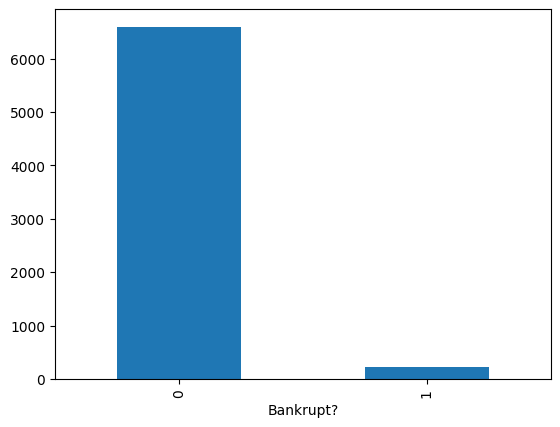

In [111]:
count_classes = data['Bankrupt?'].value_counts()
count_classes.plot(kind = 'bar')

# Modeling

### Complement Naive Bayes (CNB) Algorithm

Complement Naive Bayes is particularly suited to work with imbalanced datasets. <br>
In complement Naive Bayes, instead of calculating the probability of an item belonging to a certain class, we calculate the probability of the item belonging to all the classes.

_**When to use CNB?**_

When the dataset is imbalanced: If the dataset on which classification is to be done is imbalanced, Multinomial and Gaussian Naive Bayes may give a low accuracy. <br>
However, Complement Naive Bayes will perform quite well and will give relatively higher accuracy.

In [102]:
sns.pairplot(data, hue="Bankrupt?")

In [103]:
data.head()

,Bankrupt?,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,...,Quick Assets/Current Liability,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price
0,1,0.00,0.00,0.00,0.00,0.02,4980000000.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.68,0.03,701000000.00,6550000000.00,458000000.00,0.42,0.01
1,1,0.00,0.00,0.00,0.00,0.02,6110000000.00,0.00,0.01,0.00,...,0.00,0.00,0.01,0.31,0.02,0.00,7700000000.00,2490000000.00,0.47,0.01
2,1,0.00,25500000.00,0.00,0.00,0.01,7280000000.00,0.00,0.01,0.01,...,0.01,5340000000.00,0.01,0.45,0.00,0.00,0.00,761000000.00,0.28,0.04
3,1,0.00,0.00,0.00,0.00,0.01,4880000000.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.62,0.02,8140000000.00,6050000000.00,2030000000.00,0.56,0.00
4,1,7890000000.00,0.00,0.00,0.00,0.03,5510000000.00,0.00,0.01,0.00,...,0.00,0.00,0.00,0.98,0.00,6680000000.00,5050000000.00,824000000.00,0.31,0.00


Complementary NB:

Training: Accuracy = 0.77, Precision = 0.06, Recall = 0.43
Testing: Accuracy = 0.75, Precision = 0.06, Recall = 0.41

Classifier Report : 

               precision    recall  f1-score   support

           0       0.97      0.77      0.86      1313
           1       0.06      0.41      0.11        51

    accuracy                           0.75      1364
   macro avg       0.52      0.59      0.48      1364
weighted avg       0.94      0.75      0.83      1364



array([[1008,   30],
       [ 305,   21]])

<function matplotlib.pyplot.show(close=None, block=None)>

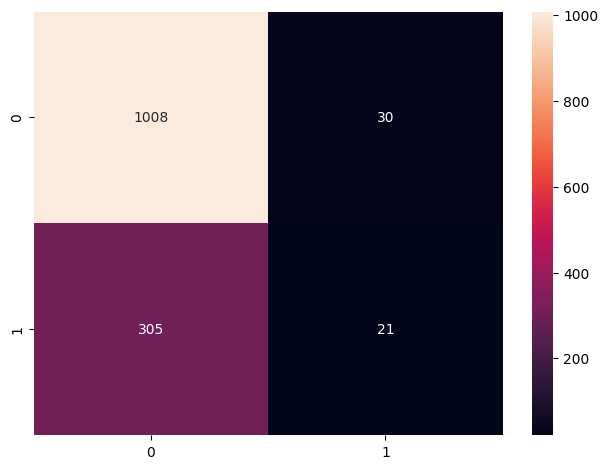

In [104]:
# Import required modules
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score
from sklearn.naive_bayes import ComplementNB
  
X = data.drop(columns="Bankrupt?")
y = data["Bankrupt?"]
  
# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)
  
# Creating and training the Complement Naive Bayes Classifier
classifier = ComplementNB()
classifier.fit(X_train, y_train)
  
# Evaluating the classifier
prediction_train = classifier.predict(X_train)
prediction_test = classifier.predict(X_test)

acc_train = accuracy_score(y_train, prediction_train)
acc_test = accuracy_score(y_test, prediction_test)

prec_train = precision_score(y_train, prediction_train)
prec_test = precision_score(y_test, prediction_test)

recall_train = recall_score(y_train, prediction_train)
recall_test = recall_score(y_test, prediction_test)
  
print(f"Complementary NB:")
print()
print(f"Training: Accuracy = {round(acc_train, 2)}, Precision = {round(prec_train, 2)}, Recall = {round(recall_train, 2)}")
print(f"Testing: Accuracy = {round(acc_test, 2)}, Precision = {round(prec_test, 2)}, Recall = {round(recall_test, 2)}")
print()
print(f"Classifier Report : \n\n {classification_report(y_test, prediction_test)}")

from sklearn.metrics import confusion_matrix
confusionMatrix = confusion_matrix(prediction_test, y_test)

display(confusionMatrix)
sns.heatmap(confusionMatrix, fmt='.0f', annot=True)
plt.tight_layout()
plt.show

We get an accuracy of 76.99% on the training set and an accuracy of 75.43% on the test set. <br>
They are pretty much the same and are actually quite good given the quality of the dataset. <br>
This dataset is notorious for being difficult to classify with simple classifiers like the one we have used here. <br>
So the accuracy is acceptable.

Conclusion:
Next time we come across an unbalanced dataset, we can try using Complement Naive Bayes.

In [105]:
# Let's start by applying RandomizedSearchCV for Decision Tree classifier:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier

# Define the parameter grid
param_dist = {
    "max_depth": [None] + list(np.arange(2, 50)),
    "min_samples_split": range(2, 200),
    "min_samples_leaf": range(1, 200),
    "criterion": ["gini", "entropy"],
}

# Create a decision tree object
tree = DecisionTreeClassifier()

# Instantiate the RandomizedSearchCV object
tree_cv = RandomizedSearchCV(tree, param_dist, cv=5, n_iter=50)

# Fit it to the data
tree_cv.fit(X_train, y_train)

# Print the tuned parameters and score
print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))

Tuned Decision Tree Parameters: {'min_samples_split': 112, 'min_samples_leaf': 123, 'max_depth': 41, 'criterion': 'entropy'}


In [106]:
# Then, based on the results of the randomized search, create a more specific grid for GridSearchCV:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid based on the results of random search
param_grid = {
    "max_depth": list(range(tree_cv.best_params_["max_depth"] - 2, tree_cv.best_params_["max_depth"] + 2)),
    "min_samples_split": list(range(tree_cv.best_params_["min_samples_split"] - 2, tree_cv.best_params_["min_samples_split"] + 2)),
    "min_samples_leaf": list(range(tree_cv.best_params_["min_samples_leaf"] - 2, tree_cv.best_params_["min_samples_leaf"] + 2)),
    "criterion": [tree_cv.best_params_["criterion"]],
}

# Create a decision tree object
tree = DecisionTreeClassifier()

# Instantiate the GridSearchCV object
tree_cv_grid = GridSearchCV(tree, param_grid, cv=5)

# Fit it to the data
tree_cv_grid.fit(X_train, y_train)

# Print the tuned parameters and score
print("Tuned Decision Tree Parameters: {}".format(tree_cv_grid.best_params_))

Tuned Decision Tree Parameters: {'criterion': 'entropy', 'max_depth': 39, 'min_samples_leaf': 121, 'min_samples_split': 110}


# Handling imbalance with Oversampling minority

In [131]:
# oversampling / undersampling is only to be done on the TRAINING set
# our test set still must reflect reality!

train = pd.concat([X_train_scaled, y_train],axis=1)
train

,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price,Bankrupt?
0,1.53,0.29,-0.15,0.77,-0.03,0.01,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,-1.64,-0.09,2.93,1.25,0.03,0.62,-0.05,0
1,-0.62,-0.75,-0.15,-0.84,-0.03,-1.92,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,1.07,-0.09,-0.42,-0.64,-0.84,-1.18,-0.05,0
2,-0.62,-0.75,-0.15,0.54,-0.03,-1.92,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,-0.59,-0.09,-0.42,-0.64,-0.53,-0.49,-0.05,0
3,-0.52,-0.75,-0.15,1.02,-0.03,1.27,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.15,-0.09,2.09,1.21,-0.84,-0.36,-0.05,0
4,-0.62,-0.75,-0.15,0.25,-0.03,0.34,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,-0.08,-0.09,-0.42,2.12,-0.58,-0.65,-0.05,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5450,0.27,-0.47,-0.15,0.74,-0.03,0.37,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.96,-0.09,3.11,1.41,-0.84,-0.84,-0.05,0
5451,-0.62,2.30,-0.15,-0.75,-0.03,0.77,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.88,-0.09,-0.42,-0.64,1.98,-0.04,-0.05,0
5452,-0.62,-0.75,-0.15,-0.41,-0.03,0.11,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.93,-0.09,-0.42,2.21,-0.84,-1.08,-0.05,0
5453,-0.62,-0.75,-0.15,-0.14,-0.03,-1.63,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,1.15,-0.09,-0.42,2.31,-0.84,0.19,-0.05,0


Bankrupt?
0    6599
1     220
Name: count, dtype: int64


(6599, 31)

(220, 31)

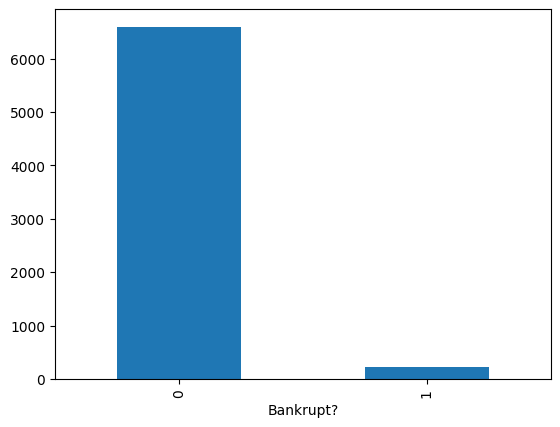

In [116]:
# before oversampling
count_classes = data['Bankrupt?'].value_counts()
count_classes.plot(kind = 'bar')

print(count_classes)

notBankrupt = data[data['Bankrupt?']==0]
bankrupt = data[data['Bankrupt?']==1]

display(notBankrupt.shape)
display(bankrupt.shape)

(5286, 31)

(169, 31)

Bankrupt?
0    5286
1     169
Name: count, dtype: int64


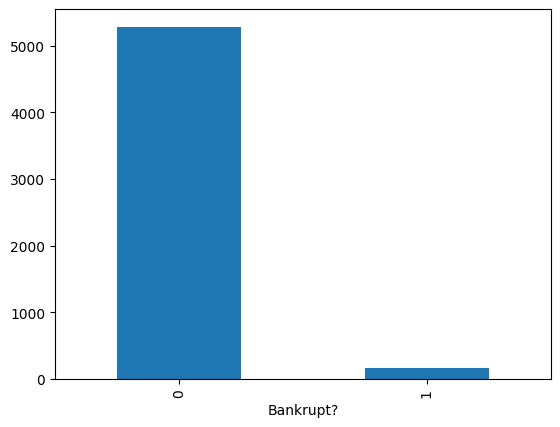

In [117]:
# separate majority/minority classes
notBankrupt = train[train['Bankrupt?']==0]
bankrupt = train[train['Bankrupt?']==1]

display(notBankrupt.shape)
display(bankrupt.shape)

count_classes = train['Bankrupt?'].value_counts()
count_classes.plot(kind = 'bar')

print(count_classes)

In [119]:
# oversample minority
from sklearn.utils import resample
bankrupt_oversampled = resample(bankrupt, #<- sample from here
                                    replace=True, #<- we need replacement, since we don't have enough data otherwise
                                    n_samples = len(notBankrupt),#<- make both sets the same size
                                    random_state=0)

# both sets are now of a reasonable size
display(notBankrupt.shape)
display(bankrupt_oversampled.shape)

(5286, 31)

(5286, 31)

In [130]:
display(bankrupt.groupby(bankrupt.columns.tolist(),as_index=False).size().head())
display(bankrupt_oversampled.groupby(bankrupt_oversampled.columns.tolist(),as_index=False).size().head())

,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price,Bankrupt?,size
0,-0.62,0.06,-0.15,-0.84,-0.03,0.30,-0.01,-0.01,-0.03,-0.03,...,-0.10,-0.22,-0.09,-0.42,-0.64,-0.52,0.02,-0.05,1,1
1,-0.62,-0.75,-0.15,-0.84,-0.03,0.59,-0.01,-0.01,-0.03,-0.03,...,-0.10,-0.83,-0.09,-0.42,2.22,-0.83,1.78,-0.05,1,1
2,-0.62,-0.69,-0.15,-0.84,-0.03,-0.17,-0.01,-0.01,-0.03,-0.03,...,-0.10,0.75,-0.09,-0.42,0.50,-0.48,1.55,-0.05,1,1
3,-0.62,0.49,-0.15,-0.84,-0.03,-0.07,-0.01,-0.01,-0.03,-0.03,...,-0.10,0.24,-0.09,3.03,1.97,0.34,1.98,-0.05,1,1
4,-0.62,-0.53,-0.15,0.05,-0.03,-1.69,-0.01,-0.01,-0.03,-0.03,...,-0.10,-1.21,-0.09,-0.42,-0.64,0.04,-0.74,-0.05,1,1


,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price,Bankrupt?,size
0,-0.62,0.06,-0.15,-0.84,-0.03,0.30,-0.01,-0.01,-0.03,-0.03,...,-0.10,-0.22,-0.09,-0.42,-0.64,-0.52,0.02,-0.05,1,32
1,-0.62,-0.75,-0.15,-0.84,-0.03,0.59,-0.01,-0.01,-0.03,-0.03,...,-0.10,-0.83,-0.09,-0.42,2.22,-0.83,1.78,-0.05,1,24
2,-0.62,-0.69,-0.15,-0.84,-0.03,-0.17,-0.01,-0.01,-0.03,-0.03,...,-0.10,0.75,-0.09,-0.42,0.50,-0.48,1.55,-0.05,1,45
3,-0.62,0.49,-0.15,-0.84,-0.03,-0.07,-0.01,-0.01,-0.03,-0.03,...,-0.10,0.24,-0.09,3.03,1.97,0.34,1.98,-0.05,1,27
4,-0.62,-0.53,-0.15,0.05,-0.03,-1.69,-0.01,-0.01,-0.03,-0.03,...,-0.10,-1.21,-0.09,-0.42,-0.64,0.04,-0.74,-0.05,1,34


In [122]:
# add oversampled data to original data
train_oversampled = pd.concat([notBankrupt,bankrupt_oversampled],axis=0)
train_oversampled.tail()

,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Total Asset Growth Rate,Net Value Growth Rate,Current Ratio,Quick Ratio,Total debt/Total net worth,...,Cash/Current Liability,Inventory/Current Liability,Current Liabilities/Liability,Long-term Liability to Current Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Cash Turnover Rate,Fixed Assets to Assets,Total assets to GNP price,Bankrupt?
4288,-0.62,0.77,-0.15,-0.84,-0.03,-0.14,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,1.14,-0.09,-0.42,1.95,-0.11,0.61,-0.05,1
3620,-0.62,-0.75,-0.15,-0.84,-0.03,-0.00,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.19,-0.09,-0.42,-0.64,2.34,-0.21,-0.05,1
1584,2.27,0.88,-0.15,-0.84,-0.03,0.42,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.33,-0.09,-0.42,-0.64,-0.54,0.51,-0.05,1
4387,-0.62,-0.11,-0.15,-0.84,-0.03,0.03,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,1.15,-0.09,-0.08,1.89,-0.13,-1.08,-0.05,1
1685,-0.62,-0.64,-0.15,0.67,-0.03,0.12,-0.01,-0.01,-0.03,-0.03,...,-0.06,-0.10,0.88,-0.09,-0.42,-0.64,-0.61,-1.03,-0.05,1


In [123]:
y_train_over = train_oversampled['Bankrupt?'].copy()
X_train_over = train_oversampled.drop('Bankrupt?',axis = 1).copy()

In [133]:
# Try using MinMaxScaler() to preprocess the data before sending the data to the model. This normalizes it to the range 0 to 1 thus removing the negative numbers.

from sklearn.preprocessing import MinMaxScaler #fixed import

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [134]:
# Creating and training the Complement Naive Bayes Classifier
classifier = ComplementNB()
classifier.fit(X_train_over, y_train_over)
  
# Evaluating the classifier
prediction_train = classifier.predict(X_train_scaled)
prediction_test = classifier.predict(X_test)

acc_train = accuracy_score(y_train, prediction_train)
acc_test = accuracy_score(y_test, prediction_test)

prec_train = precision_score(y_train, prediction_train)
prec_test = precision_score(y_test, prediction_test)

recall_train = recall_score(y_train, prediction_train)
recall_test = recall_score(y_test, prediction_test)
  
print(f"Complementary NB:")
print()
print(f"Training: Accuracy = {round(acc_train, 2)}, Precision = {round(prec_train, 2)}, Recall = {round(recall_train, 2)}")
print(f"Testing: Accuracy = {round(acc_test, 2)}, Precision = {round(prec_test, 2)}, Recall = {round(recall_test, 2)}")
print()
print(f"Classifier Report : \n\n {classification_report(y_test, prediction_test)}")

from sklearn.metrics import confusion_matrix
confusionMatrix = confusion_matrix(prediction_test, y_test)

display(confusionMatrix)
sns.heatmap(confusionMatrix, fmt='.0f', annot=True)
plt.tight_layout()
plt.show

ValueError: Negative values in data passed to ComplementNB (input X)